In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import momepy as mm

/Users/gregoriomaya/mambaforge/envs/test/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import osmnx as ox
from shapely.ops import polygonize, polygonize_full
import folium

In [ ]:
#point = 40.41932, -3.69307 #cibeles, Madrid
#dist = 1500
#G = ox.graph_from_point(point, dist=dist, network_type='drive', simplify = True)

In [4]:
place = 'Madrid, Área metropolitana de Madrid y Corredor del Henares, Community of Madrid, Spain'
G = ox.graph_from_place(place, network_type='drive', simplify = True)
G_projected = ox.project_graph(G)

edges = ox.graph_to_gdfs(ox.get_undirected(G_projected), #prevents some (semi)duplicate geoms
                         nodes=False, edges=True,
                         node_geometry=False, fill_edge_geometry=True)
edges.to_crs(2062, inplace= True)

In [5]:
#polygonizing
results, cuts, dangles, invalids = polygonize_full(edges.geometry)

#outputs into GDF for plotting/exploring
res = gpd.GeoDataFrame(data= ['resuls' for d in results.geoms], columns= ['h'],
                                  geometry = [g for g in results.geoms], crs=edges.crs)
cut = gpd.GeoDataFrame(data= ['cuts' for d in cuts.geoms], columns= ['h'],
                                  geometry = [g for g in cuts.geoms], crs=edges.crs)
inv = gpd.GeoDataFrame(data= ['invalid' for d in invalids.geoms], columns= ['h'],
                                  geometry = [g for g in invalids.geoms], crs=edges.crs)
dan = gpd.GeoDataFrame(data= ['dangle' for d in dangles.geoms], columns= ['h'],
                                  geometry = [g for g in dangles.geoms], crs=edges.crs)

In [6]:
m = res.explore(color = 'grey', name='polygons')

cut.explore(m=m, color= 'red', name = 'cuts')
inv.explore(m=m, color = 'green', name= 'invalids')
dan.explore(m=m , color = 'black', name='dangles')

folium.LayerControl().add_to(m)  # layer control
m

In [7]:
#creating some new parameters 
res["area"] = res.geometry.area
res['log_area'] = np.log(res['area'])

res["circom"] = mm.CircularCompactness(res, "area").series

<AxesSubplot:xlabel='log_area', ylabel='circom'>

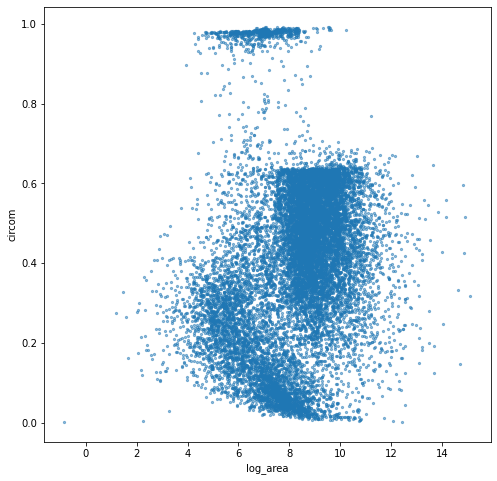

In [8]:
res.plot.scatter(x="log_area", y="circom", 
                 marker = '.', 
                 alpha = 0.5,
                figsize=(8,8))

# Trying to replicate Martin's apprach

In [66]:
#creating parameters that potentially determine the initial fase of the classification

res['circom_sqarea'] = res.circom / np.sqrt(res.area)
res['area_sqrtcircom'] = res.area / np.sqrt(res.circom)

In [80]:
x = res['area_sqrtcircom']

n = len(x)
rang = x.max() - x.min()
intervals  = np.sqrt(n)
bins =  rang / intervals
bins

51084.39307343125

<AxesSubplot:ylabel='Frequency'>

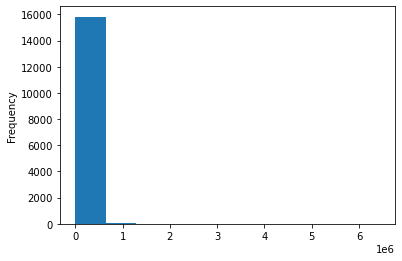

In [102]:
res['area_sqrtcircom'].plot.hist()# bins = bins )

# k means

In [141]:
import matplotlib.pyplot as plt

In [104]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [176]:
features = res[['area','circom']].to_numpy()

#standarization of values given their different ranges 
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)
scaled_features

array([[-0.00858171,  0.7097702 ],
       [-0.04784011,  0.36422049],
       [-0.19919663, -0.74419773],
       ...,
       [-0.1842317 ,  2.74935594],
       [-0.17825061, -0.27250351],
       [-0.18436672, -0.19763591]])

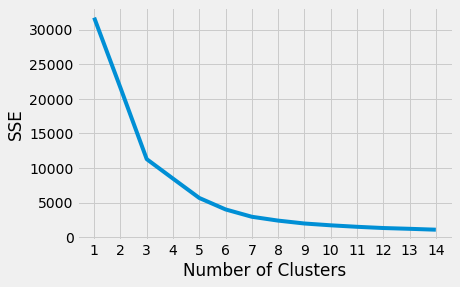

In [179]:
#looping through several cluster options to determine the correct number
sse = []
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k)#, **kmeans_kwargs)
    kmeans.fit(scaled_features)
    sse.append(kmeans.inertia_)
    
plt.style.use("fivethirtyeight")
plt.plot(range(1, 15), sse)
plt.xticks(range(1, 15))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

In [187]:
#initializing the class
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)
kmeans.fit(scaled_features)
#kmeans.cluster_centers_

KMeans(init='random', n_clusters=3, random_state=42)

<AxesSubplot:xlabel='log_area', ylabel='circom'>

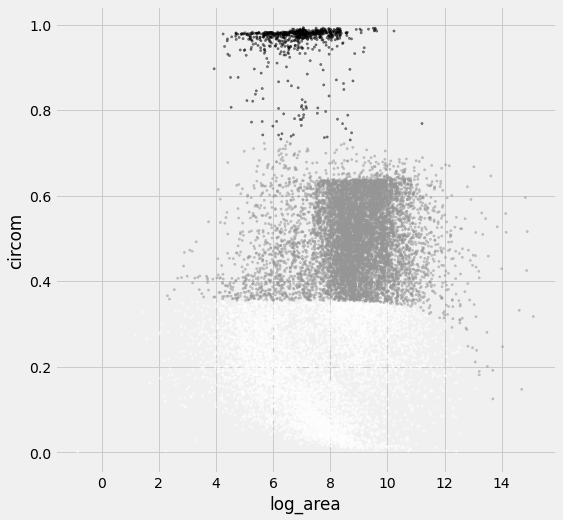

In [188]:
c = pd.Series(kmeans.labels_, dtype='category')

res.plot.scatter(x="log_area", y="circom", 
                color = c,
                 marker = '.', 
                 alpha = 0.5,
                figsize=(8,8))

In [189]:
#how does that look in a map
res['kmeans_label'] = pd.Series(kmeans.labels_, dtype='category')

res.explore('kmeans_label')

# logistic regression
Does this work even without having a labelled dataset ? -- probably not